In [ ]:
# plot the entirety of the raw data, i.e. for each subject for each scenario for each channel = 3x4x8 = 96 pltos
# compute descriptive statistics such as boxplots/violinplots, histograms, kernel density plots for all

# remove artefacts? how do the plots look afterwards, i.e. is it noticeable in any way?

# plot data corresponding to features: 3x4x8x9 = too many plots
# reduce number of features by:
#   1. removing highly correlated ones
#   2. projecting the data to a lower dimensional feature space via PCA/LDA
#   3. perform forward/backward selection

# is there statistically significant intra-personal, i.e. inter-scenario difference?
# is there statisitcally signficant inter-personal difference?

# there appear to be significant inter-personal variations -> in-depth analysis: t-test, anova
# what do we do if the difference is statistically significant?
# check wheter these differences are only present in the raw data or in the features as well

# train/test model according to cross and anti-cross subject paradigm

In [ ]:
%load_ext autoreload
%autoreload 2

from google.colab import drive
drive.mount('/content/gdrive', force_remount=True)
%cd /content/gdrive/My Drive/Colab Notebooks/BCI/data

%ls

Mounted at /content/gdrive
/content/gdrive/My Drive/Colab Notebooks/BCI/data
s1_driving_and_nback_Donald.fif   s2_idle_Donald.fif
s1_driving_and_nback_Ganavi.fif   s2_idle_Ganavi.fif
s1_driving_and_nback_Nicolas.fif  s2_idle_Nicolas.fif
s1_driving_Donald.fif             s2_nback_Donald.fif
s1_driving_Ganavi.fif             s2_nback_Ganavi.fif
s1_driving_Nicolas.fif            s2_nback_Nicolas.fif
s1_idle_Donald.fif                s3_driving_and_nback_Donald.fif
s1_idle_Ganavi.fif                s3_driving_and_nback_Ganavi.fif
s1_idle_Nicolas.fif               s3_driving_and_nback_Nicolas.fif
s1_nback_Donald.fif               s3_driving_Donald.fif
s1_nback_Ganavi.fif               s3_driving_Ganavi.fif
s1_nback_Nicolas.fif              s3_driving_Nicolas.fif
s2_driving_and_nback_Donald.fif   s3_idle_Donald.fif
s2_driving_and_nback_Ganavi.fif   s3_idle_Ganavi.fif
s2_driving_and_nback_Nicolas.fif  s3_idle_Nicolas.fif
s2_driving_Donald.fif             s3_nback_Donald.fif
s2_driving_Ganavi.

In [ ]:
%%capture
!pip install mne

In [ ]:
#@title read, crop (5m valid samples interval) and filter (high & lowpass) data files
import mne
import pandas as pd
import numpy as np

scenarios = ["idle", "nback", "driving", "driving_and_nback"]
subjects = ["Donald", "Ganavi", "Nicolas"]
sessions = [1, 2, 3]
colors_matte = ["navy", "darkgreen", "maroon", "orange"] 
colors = ["blue", "green", "red", "yellow"]
markers = ["v", "^", "<", 4]

# automatically crop a subject's recording data according to it's events
def crop_recording_data(filename, subject_data):
    # extract events
    events = [el["list"] for el in subject_data.info["events"]]
    # extract last valid recorded sample
    last_sample = events[-2][0]
    # discard exit event and last valid recording event
    events = events[:-2]
    # reverse order of events
    events = events[::-1]
    # determine valid sample interval
    curent_sample = 0
    for event in events:
        # calculate elapsed time
        current_sample = event[0]
        tmp = last_sample - current_sample
        minutes = tmp/250/60
        if (minutes >= 4.8) and (minutes <= 5.22):
            print("Info for:", filename,
                  "first valid sample:", current_sample,
                  "last valid sample:", last_sample,
                  "minutes:", minutes)
            # point of cropping has to be minutes
            return subject_data.crop(tmin=current_sample/250, tmax=last_sample/250, verbose=False)


def trim_and_standardize_data(data):
    trim_std_data = []
    for channel in data:
        p1, p99 = np.percentile(channel, [1, 99])
        # replace extreme values with the appropriate percentiles
        channel[channel < p1] = p1
        channel[channel > p99] = p99
        # standardize data
        channel = (channel-channel.mean())/channel.std()
        trim_std_data.append(channel)
    return np.array(trim_std_data)

# save entire data in a nested dictionary structue, i.e.
# {
#   1: {
#         "idle": [s1_idle_Donald, s1_idle_Ganavi, s1_idle_Nicolas],
#         "nback": ...
#      },
#   2: {
#         ...
#      }
# }

data_dict = {}
filtered_data_dict = {}
channel_names = mne.io.read_raw_fif("./s3_idle_Donald.fif", preload=True, verbose="Error").pick("eeg").ch_names

# constrct filtered data dict for plotting purposes and unfiltered for further processing
# (since filtering removes information that is beneficial for classification)
for session in sessions:
    # save data for one session across all scenarios and subjects
    session_dict = {}
    filtered_session_dict = {}
    for scenario in scenarios:
        # save data for one scenario across all subjects
        subject_data_array = []
        filtered_subject_data_array = []
        for subject in subjects:
            # construct filename
            filename = "s"+str(session)+"_"+scenario+"_"+subject+".fif"
            # read subject data
            data = mne.io.read_raw_fif(filename, preload=True, verbose="Error").pick("eeg")
            # crop subject data
            cropped_data = crop_recording_data(filename, data)
            # filter cropped subject data
            filtered_data = cropped_data.copy().filter(l_freq=0.1, h_freq=49.9, picks="all", method="fir",
                                                fir_window="hamming", fir_design='firwin', verbose=False)
            # trim and standardize unfiltered data
            unfiltered = trim_and_standardize_data(cropped_data.get_data())
            # trim and standardize filtered data
            filtered = trim_and_standardize_data(filtered_data.get_data())
            # append subject data for one scenario
            subject_data_array.append(unfiltered)
            filtered_subject_data_array.append(filtered)
        # fill dict, mapping scenario to all subjects' data
        session_dict.update({scenario:subject_data_array})
        filtered_session_dict.update({scenario:filtered_subject_data_array})
    # fill dict, mapping session number to all scenarios
    data_dict.update({session:session_dict})
    filtered_data_dict.update({session:filtered_session_dict})

Info for: s1_idle_Donald.fif first valid sample: 9529 last valid sample: 84799 minutes: 5.018
Info for: s1_idle_Ganavi.fif first valid sample: 9469 last valid sample: 85559 minutes: 5.072666666666667
Info for: s1_idle_Nicolas.fif first valid sample: 10259 last valid sample: 86239 minutes: 5.065333333333333
Info for: s1_nback_Donald.fif first valid sample: 6839 last valid sample: 82289 minutes: 5.03
Info for: s1_nback_Ganavi.fif first valid sample: 164019 last valid sample: 240479 minutes: 5.097333333333333
Info for: s1_nback_Nicolas.fif first valid sample: 234509 last valid sample: 310599 minutes: 5.072666666666667
Info for: s1_driving_Donald.fif first valid sample: 265529 last valid sample: 342809 minutes: 5.152
Info for: s1_driving_Ganavi.fif first valid sample: 11649 last valid sample: 87879 minutes: 5.082
Info for: s1_driving_Nicolas.fif first valid sample: 43759 last valid sample: 119309 minutes: 5.036666666666666
Info for: s1_driving_and_nback_Donald.fif first valid sample: 4359 

In [ ]:
%matplotlib inline
#@title function for plotting eeg data across all channels and subjects
import matplotlib.pyplot as plt

def plot_raw_data(data):
    fig, axs = plt.subplots(nrows=8, ncols=4, sharex="col", sharey="row", figsize=(15, 15))
    colors = ["b", "g", "r"]

    [ax.set_title(column_name) for ax, column_name in zip(axs[0], scenarios)]
    [ax.set_ylabel(row_name, size='large') for ax, row_name in zip(axs[:,0], channel_names)]

    for channel in range(axs.shape[0]):
        for scenario, scenario_name in enumerate(scenarios):
            for subject, color in enumerate(colors):
                axs[channel,scenario].plot(data[scenario_name][subject][channel].T,
                                           color=color,
                                           alpha=0.6,
                                           label=subjects[subject])
    return fig     

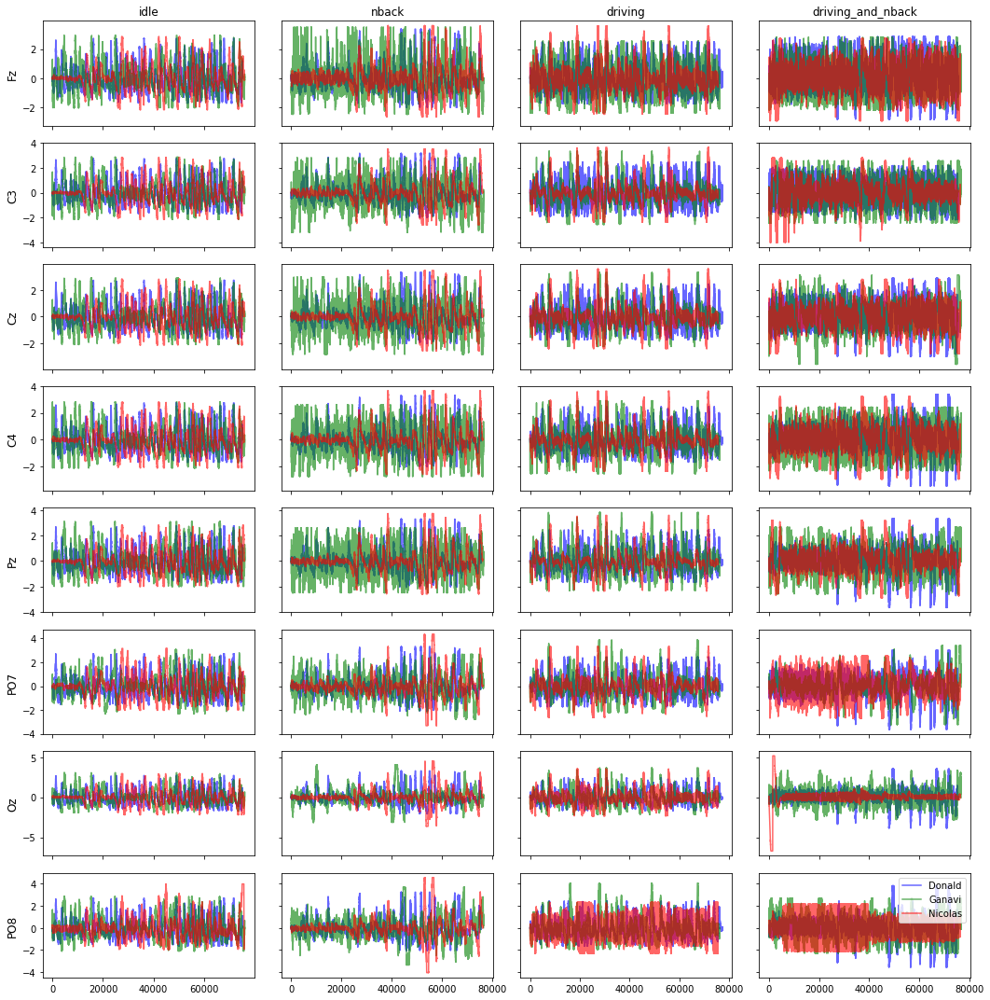

In [ ]:
#@title plot standardized, filtered data of the first recording session across all channels and subjects
fig = plot_raw_data(filtered_data_dict[1])
plt.legend(loc="upper right")
fig.tight_layout()
plt.show()

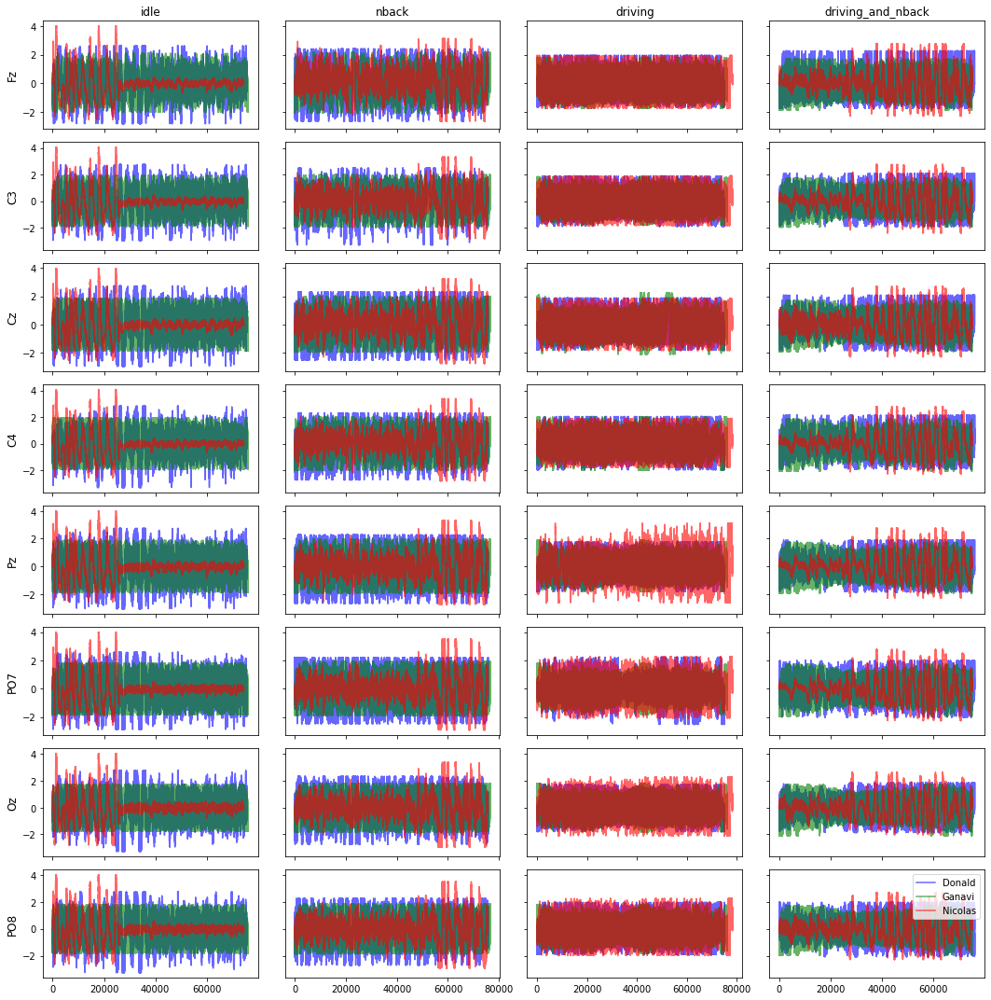

In [ ]:
%matplotlib inline
#@title plot standardized, filtered data of the second recording session across all channels and subjects
fig = plot_raw_data(filtered_data_dict[3])
fig.tight_layout()
plt.legend(loc="upper right")
plt.show()

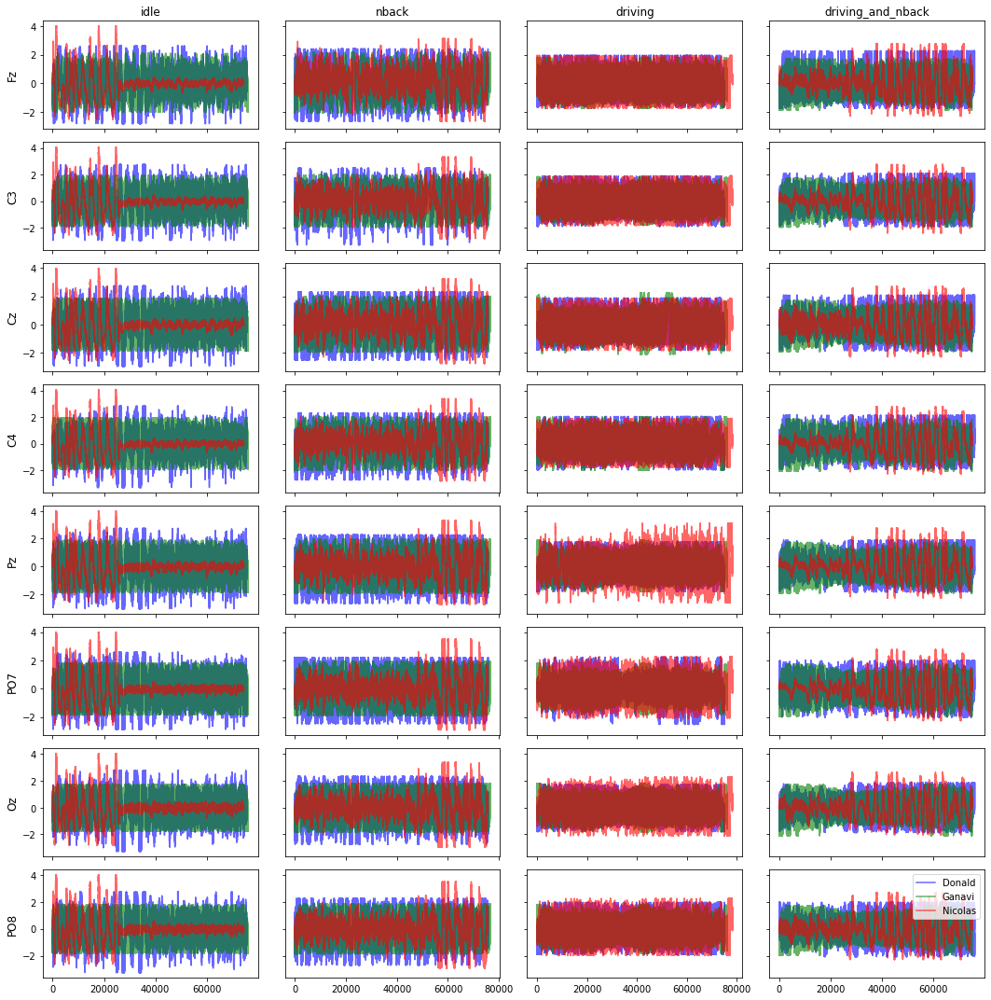

In [ ]:
%matplotlib inline
#@title plot standardized, filtered data of the second recording session across all channels and subjects
fig = plot_raw_data(filtered_data_dict[3])
fig.tight_layout()
plt.legend(loc="upper right")
plt.show()

In [ ]:
%matplotlib inline
#@title boxplot plotting function

def plot_boxplots(session_data_dict):
    np.warnings.filterwarnings('ignore', category=np.VisibleDeprecationWarning)
    fig, axs = plt.subplots(nrows=8, ncols=1, sharex="none", sharey="row", figsize=(15, 15))

    scenarios_abv = ["i", "n", "d", "d&n"]
    colors = ["b", "g", "r", "y"]
    positions = {"idle": [2,3,4],
                "nback": [6,7,8],
                "driving": [10,11,12],
                "driving_and_nback": [14,15,16]}

    for ax, row_name in zip(axs, channel_names):
        ax.set_ylabel(row_name, size='large') 
        ax.yaxis.grid(True)

    for channel in range(axs.shape[0]):
        scenario_bxplt = []
        for scenario, scenario_name in enumerate(scenarios):
            bxplt = axs[channel].boxplot([session_data_dict[scenario_name][0][channel].T,
                                          session_data_dict[scenario_name][1][channel].T,
                                          session_data_dict[scenario_name][2][channel].T], 
                            labels=["d:"+scenarios_abv[scenario],
                                    "g:"+scenarios_abv[scenario],
                                    "n:"+scenarios_abv[scenario]],
                            positions=positions[scenario_name],
                            showmeans=True, patch_artist=True, vert=True, whis=1.5)
            scenario_bxplt.append(bxplt)
        # fill with colors
        for bxplt, color in zip(scenario_bxplt, colors):
            for patch in bxplt['boxes']:
                patch.set_facecolor(color)

    fig.tight_layout()
    return fig    

In [ ]:
#@title merge individual subject datasets into one common scenario dataset as a mne.Raw object

# each scenario should be 3x5m = 15m
def merge_data(data, session, verbose):
    scenarios_mne_dict = {}
    # create dummy info object (required)
    info = mne.create_info(ch_names=channel_names,
                          ch_types=['eeg'] * len(channel_names),
                          sfreq=250)
    if verbose: print("\n@@@ session "+str(session)+" data @@@")
    # concatenate subjects' data for each scenario
    for scenario_name, scenario_data in data.items():
        data = np.concatenate(tuple(scenario_data), axis=1)
        scenario_raw = mne.io.RawArray(data, info, verbose=False)
        if verbose: print("s"+str(session)+"_"+scenario_name+" time in minutes: ", len(scenario_raw)/250/60) 
        scenarios_mne_dict.update({scenario_name:scenario_raw})
    return scenarios_mne_dict

In [ ]:
#@title compute the psd of each single frequency across the entire time series data segmented in 1s windows with a 50% overlap

# 15 minutes per session & scenario = 15*60 = 900 seconds with 50% overlap = 1800 seconds
def compute_psd(data, session, verbose):
    scenario_psd_dict = {}
    if verbose: print("\n@@@ session "+str(session)+" data @@@")
    for scenario_name, scenario_data in data.items():
        scenario_psd, _ = mne.time_frequency.psd_welch(scenario_data, fmin=0, fmax=50, tmin=None, tmax=None,
                                                        n_fft=250, n_overlap=125, n_per_seg=250, picks=None,
                                                        proj=False, n_jobs=1, reject_by_annotation=True, average=None,
                                                        window='blackman', verbose=False)
        scenario_psd_dict.update({scenario_name:scenario_psd})
        # (channels, frequencies, time segments)
        if verbose: print("s"+str(session)+"_"+scenario_name+".shape: ", scenario_psd.shape)
    return scenario_psd_dict


In [ ]:
#@title extract features from psd values

# expects a dataset corresponding to the merged data of all subjects of one scenario
def compute_features(scenario_psd):
    # get frequency bands
    delta = scenario_psd[:,0:4,:]
    theta = scenario_psd[:,4:8,:]
    alpha = scenario_psd[:,8:13,:]
    beta = scenario_psd[:,12:31,:]
    gamma = scenario_psd[:,31:51,:]

    # ASSUMPTION #
    # we take the average of the different frequencies defined in the ranges of δ (<4 Hz), θ (4–7 Hz),
    # α (8–12 Hz), β (12–30 Hz), and γ (31–50 Hz) to get a single representative value
    delta_mean = np.mean(delta, axis=1)
    theta_mean = np.mean(theta, axis=1)
    alpha_mean = np.mean(alpha, axis=1)
    beta_mean = np.mean(beta, axis=1)
    gamma_mean = np.mean(gamma, axis=1)

    # replace extreme value with the 5th and 95th percentile respectively
    absolute_features = [delta_mean, theta_mean, alpha_mean, beta_mean, gamma_mean]
    for feature in absolute_features:
        p1s, p99s = np.percentile(feature, [1,99], axis=1)
        for channel, (p1, p99) in enumerate(zip(p1s,p99s)):
          feature[channel, feature[channel] < p1] = p1
          feature[channel, feature[channel] > p99] = p99

    # calculate some ratios given in the paper: 
    # Barua, Shaibal, Mobyen Uddin Ahmed, and Shahina Begum. "Towards intelligent data analytics: 
    # A case study in driver cognitive load classification." Brain sciences 10.8 (2020): 526.
    r1 = (alpha_mean + theta_mean)/beta_mean
    r2 = alpha_mean/beta_mean
    r3 = (alpha_mean + theta_mean)/(alpha_mean + beta_mean)
    r4 = theta_mean/beta_mean

    # construct dictionary with all features for each column for easy transformation to pandas dataframe later
    columns = {
        "Fz_delta": delta_mean[0,:],
        "Fz_theta": theta_mean[0,:],
        "Fz_alpha": alpha_mean[0,:],
        "Fz_beta": beta_mean[0,:],
        "Fz_gamma": gamma_mean[0,:],
        "Fz_r1": r1[0,:],
        "Fz_r2": r2[0,:],
        "Fz_r3": r3[0,:],
        "Fz_r4": r4[0,:],

        "C3_delta": delta_mean[1,:],
        "C3_theta": theta_mean[1,:],
        "C3_alpha": alpha_mean[1,:],
        "C3_beta": beta_mean[1,:],
        "C3_gamma": gamma_mean[1,:],
        "C3_r1": r1[1,:],
        "C3_r2": r2[1,:],
        "C3_r3": r3[1,:],
        "C3_r4": r4[1,:],

        "Cz_delta": delta_mean[2,:],
        "Cz_theta": theta_mean[2,:],
        "Cz_alpha": alpha_mean[2,:],
        "Cz_beta": beta_mean[2,:],
        "Cz_gamma": gamma_mean[2,:],
        "Cz_r1": r1[2,:],
        "Cz_r2": r2[2,:],
        "Cz_r3": r3[2,:],
        "Cz_r4": r4[2,:],

        "C4_delta": delta_mean[3,:],
        "C4_theta": theta_mean[3,:],
        "C4_alpha": alpha_mean[3,:],
        "C4_beta": beta_mean[3,:],
        "C4_gamma": gamma_mean[3,:],
        "C4_r1": r1[3,:],
        "C4_r2": r2[3,:],
        "C4_r3": r3[3,:],
        "C4_r4": r4[3,:],

        "Pz_delta": delta_mean[4,:],
        "Pz_theta": theta_mean[4,:],
        "Pz_alpha": alpha_mean[4,:],
        "Pz_beta": beta_mean[4,:],
        "Pz_gamma": gamma_mean[4,:],
        "Pz_r1": r1[4,:],
        "Pz_r2": r2[4,:],
        "Pz_r3": r3[4,:],
        "Pz_r4": r4[4,:],

        "P07_delta": delta_mean[5,:],
        "P07_theta": theta_mean[5,:],
        "P07_alpha": alpha_mean[5,:],
        "P07_beta": beta_mean[5,:],
        "P07_gamma": gamma_mean[5,:],
        "P07_r1": r1[5,:],
        "P07_r2": r2[5,:],
        "P07_r3": r3[5,:],
        "P07_r4": r4[5,:],

        "Oz_delta": delta_mean[6,:],
        "Oz_theta": theta_mean[6,:],
        "Oz_alpha": alpha_mean[6,:],
        "Oz_beta": beta_mean[6,:],
        "Oz_gamma": gamma_mean[6,:],
        "Oz_r1": r1[6,:],
        "Oz_r2": r2[6,:],
        "Oz_r3": r3[6,:],
        "Oz_r4": r4[6,:],

        "P08_delta": delta_mean[7,:],
        "P08_theta": theta_mean[7,:],
        "P08_alpha": alpha_mean[7,:],
        "P08_beta": beta_mean[7,:],
        "P08_gamma": gamma_mean[7,:],
        "P08_r1": r1[7,:],
        "P08_r2": r2[7,:],
        "P08_r3": r3[7,:],
        "P08_r4": r4[7,:]
    }

    return columns

# wrapper function that removes any nan values from the extracted features (can happen because of division by 0)
def extract_features(data_dict):
    scenario_features_dict = {}
    for scenario_name, scenario_psd in data_dict.items():
      data = compute_features(scenario_psd)
      for key, value in data.items():
        if np.isnan(value).any():
          np.nan_to_num(value, copy=False, nan=0.0)
      scenario_features_dict.update({scenario_name:data})
    return scenario_features_dict

##feature plots

In [ ]:
#@title gather data for each feature across all scenarios

features = features_data_dict[1]["idle"].keys()
print(features)
feature_scenarios_dict = {}
for feature in features:
    scenarios_data = []
    for scenario in features_data_dict[1].values():
      data = scenario[feature]
      scenarios_data.append(data)
    feature_scenarios_dict.update({feature:scenarios_data})

for feature, data in feature_scenarios_dict.items():
    data_shape = []
    contains_null = []
    for index, el in enumerate(data):
        data_shape.append(el.shape)
        if np.isnan(el).any() == True:
          data[index] = np.nan_to_num(el, copy=True, nan=0.0)
          feature_scenarios_dict.update({feature:data})
          contains_null.append(True)
        else: contains_null.append(False)
    print(feature, "shape across scenarios:", data_shape, "NaNs present:", contains_null)

print("number of features:", len(features))
delta_names = [key for key in features if "delta" in key]
alpha_names = [key for key in features if "alpha" in key]
beta_names = [key for key in features if "beta" in key]
theta_names = [key for key in features if "theta" in key]
gamma_names = [key for key in features if "gamma" in key]
r1_names = [key for key in features if "r1" in key]
r2_names = [key for key in features if "r2" in key]
r3_names = [key for key in features if "r3" in key]
r4_names = [key for key in features if "r4" in key]

NameError: ignored

In [ ]:
#@title psd plotting function 
from matplotlib.pyplot import figure

def plot_feature(feature_names, title):
    fig, axs = plt.subplots(nrows=8, ncols=1, sharex="col", sharey="row", figsize=(20,20))

    colors = ["b", "g", "r", "y"]
    labels = ["idle", "nback", "driving", "driving_and_nback"]
    for i, feature in enumerate(feature_names):
        for j, scenario_data in enumerate(feature_scenarios_dict[feature]):
            axs[i].plot(scenario_data.T, color=colors[j])
            axs[i].set_ylabel(feature)

    axs[0].set_title(title)
    axs[0].legend(labels, loc="upper right")
    return fig

fig = plot_feature(delta_names, "delta values across channels & scenarios")
fig.tight_layout()
plt.show()

In [ ]:
fig = plot_feature(alpha_names, "alpha values across channels & scenarios")
fig.tight_layout()
plt.show()

In [ ]:
fig = plot_feature(beta_names, "beta values across channels & scenarios")
fig.tight_layout()
plt.show()

In [ ]:
fig = plot_feature(theta_names, "theta values across channels & scenarios")
fig.tight_layout()
plt.show()

In [ ]:
fig = plot_feature(gamma_names, "gamma values across channels & scenarios")
fig.tight_layout()
plt.show()

In [ ]:
fig = plot_feature(r1_names, "(alpha + theta)/beta values across channels & scenarios")
fig.tight_layout()
plt.show()

In [ ]:
fig = plot_feature(r2_names, "alpha/beta values across channels & scenarios")
fig.tight_layout()
plt.show()

In [ ]:
fig = plot_feature(r3_names, "(alpha + theta)/(alpha + beta) values across channels & scenarios")
fig.tight_layout()
plt.show()

In [ ]:
fig = plot_feature(r4_names, "theta/beta values across channels & scenarios")
fig.tight_layout()
plt.show()

##dataset construction

In [ ]:
import numpy as np
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split

#@title function for creating datasets from dictionary
def construct_datasets(data_dict, verbose=False):
    # maps sessions to a dict that maps scenarios to all subjects' data described by 72 features each
    X_inter_dict = {}
    y_inter_dict = {}
    X_cross_dict = {}
    y_cross_dict = {}
    if verbose: print("\n\n@@@ INTER-SESSION PARADIGM @@@")
    for session, session_dict in data_dict.items():
        merged_session_dict = merge_data(session_dict, session, verbose)
        psd_session_dict = compute_psd(merged_session_dict, session, verbose)
        features_session_dict = extract_features(psd_session_dict)
        
        dataset_dict = {}
        labels = []
        if verbose: print("\n@@@ session "+str(session)+" data @@@")
        for idx, (scenario_name, scenario_data) in enumerate(features_session_dict.items()):
            session_scenario_df = pd.DataFrame(data=scenario_data)
            if verbose: print("s"+str(session)+"_"+scenario_name+"_df.shape:", session_scenario_df.shape)
            session_scenario_labels = np.ones(len(session_scenario_df), dtype=np.int8)*idx
            labels.append(session_scenario_labels)
            dataset_dict.update({str(session)+"_"+scenario_name:session_scenario_df})

        X_inter_session = pd.concat(dataset_dict.values())
        y_inter_session = np.concatenate(labels, axis=0, dtype=np.int8)
        # shuffle data to break up scenario sequence structure
        X_inter_session, y_inter_session = shuffle(X_inter_session, y_inter_session, random_state=0)
        if verbose: print("\nX_inter_s"+str(session)+".shape:", X_inter_session.shape, "y_inter_s"+str(session)+".shape:", y_inter_session.shape)
        X_inter_dict.update({session:X_inter_session})
        y_inter_dict.update({session:y_inter_session})

    if verbose: print("\n@@@ CROSS-SESSION PARADIGM @@@\n")
    X_cross, y_cross = shuffle(pd.concat(X_inter_dict.values(), axis=0),
                               np.concatenate(list(y_inter_dict.values()), axis=0, dtype=np.int8),
                               random_state=0)
    # check for any nan values
    [print("NAN encounter in: ", c) for c in X_cross.columns if X_cross[c].isnull().values.any()]

    X_cross_train, X_cross_test, y_cross_train, y_cross_test = train_test_split(X_cross, y_cross, shuffle=True,
                                                                                random_state=0, test_size=0.7)
    X_cross_dict.update({"train":X_cross_train})
    X_cross_dict.update({"test":X_cross_test})
    y_cross_dict.update({"train":y_cross_train})
    y_cross_dict.update({"test":y_cross_test})

    if verbose: print("X_cross_train.shape:", X_cross_train.shape, "y_cross_train.shape", y_cross_train.shape)
    if verbose: print("X_cross_test.shape:", X_cross_test.shape, "y_cross_test.shape", y_cross_test.shape) 

    return X_inter_dict, y_inter_dict, X_cross_dict, y_cross_dict

X_inter_dict, y_inter_dict, X_cross_dict, y_cross_dict = construct_datasets(data_dict, verbose=True)
X_inter_dict_f, y_inter_dict_f, X_cross_dict_f, y_cross_dict_f = construct_datasets(filtered_data_dict)



@@@ INTER-SESSION PARADIGM @@@

@@@ session 1 data @@@
s1_idle time in minutes:  15.1562
s1_nback time in minutes:  15.200199999999999
s1_driving time in minutes:  15.270866666666667
s1_driving_and_nback time in minutes:  15.2182

@@@ session 1 data @@@
s1_idle.shape:  (8, 51, 1817)
s1_nback.shape:  (8, 51, 1823)
s1_driving.shape:  (8, 51, 1831)
s1_driving_and_nback.shape:  (8, 51, 1825)

@@@ session 1 data @@@
s1_idle_df.shape: (1817, 72)
s1_nback_df.shape: (1823, 72)
s1_driving_df.shape: (1831, 72)
s1_driving_and_nback_df.shape: (1825, 72)

X_inter_s1.shape: (7296, 72) y_inter_s1.shape: (7296,)

@@@ session 2 data @@@
s2_idle time in minutes:  15.122866666666665
s2_nback time in minutes:  15.082866666666666
s2_driving time in minutes:  15.185533333333332
s2_driving_and_nback time in minutes:  15.172866666666666

@@@ session 2 data @@@
s2_idle.shape:  (8, 51, 1813)
s2_nback.shape:  (8, 51, 1808)
s2_driving.shape:  (8, 51, 1821)
s2_driving_and_nback.shape:  (8, 51, 1819)

@@@ session

##PCA/SVD

In [ ]:
#@title functions for plotting data in PCA subspace
from IPython.display import HTML
from matplotlib import animation
from sklearn.decomposition import PCA

def PCA_transform(X_dict, paradigm):
    pca = PCA(n_components=3)
    # transform all recording sessions' data
    X_dict_transformed = {}
    if paradigm == "inter":
        # fit only on data of one recording session to prevent data leakage, i.e. other sessions are test data
        X_inter_train = X_dict[1]
        pca.fit(X_inter_train)
    elif paradigm == "cross":
        pca.fit(X_dict["train"])
    # percentage of variance explained for each component
    print("percentage of variance explained: %s" % str(pca.explained_variance_ratio_))
    for session, X_inter in X_dict.items():
        X_dict_transformed.update({session:pca.transform(X_inter)})
    return X_dict_transformed


def plot_PCA(X_dict, y_dict, paradigm):
    # make 3d plots available  
    %matplotlib notebook
    fig = plt.figure(figsize=(20,10)) 
    ax_pca = fig.add_subplot(111, projection='3d')

    X_total = np.concatenate(list(X_dict.values()), axis=0)
    # removes outliers for proper figure scaling
    p_min, p_max = np.percentile(X_total, [1,99], axis=0)
    x_min, y_min, z_min = p_min
    x_max, y_max, z_max = p_max

    for color, (idx, scenario) in zip(colors, enumerate(scenarios)):
            for (jdx, (session, X)), y in zip(enumerate(X_dict.items()), list(y_dict.values())):
                ax_pca.scatter(X[y==idx, 0],
                               X[y==idx, 1],
                               X[y==idx, 2],
                               color=color,
                               marker=markers[jdx],
                               alpha=0.6,
                               s=80,
                               label="s"+str(session)+"_"+scenario if paradigm=="inter" else str(session)+"_"+scenario)
                

    ax_pca.set_xlabel("First Principal Component", fontsize=14)
    ax_pca.set_ylabel("Second Principal Component", fontsize=14)
    ax_pca.set_zlabel("Third Principal Component", fontsize=14)

    ax_pca.set_xlim([x_min, x_max])
    ax_pca.set_ylim([y_min, y_max])
    ax_pca.set_zlim([z_min, z_max])

    plt.legend(loc="upper right", shadow=False, scatterpoints=1,prop={'size': 14})
    title_body = paradigm+"-session paradigm ("
    title = title_body+"train size: "+str(round(1/len(list(X_dict.keys())),1))+")" if paradigm=="inter"\
            else title_body+"train size: "+str(round(len(X_dict["train"])/len(X_total), 1))+")"

    plt.title(title, fontsize=24)

    # rotate the axes and update
    def animate(frame):
      ax_pca.view_init(30, frame/4)
      plt.pause(.001)
      return fig

    anim = animation.FuncAnimation(fig, animate, frames=200, interval=50)
    return HTML(anim.to_html5_video())

In [ ]:
X_inter_dict_PCA = PCA_transform(X_inter_dict, "inter")
plot_PCA(X_inter_dict_PCA, y_inter_dict, "inter")

percentage of variance explained: [0.45111817 0.18629603 0.10190144]


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
X_cross_dict_PCA = PCA_transform(X_cross_dict, "cross")
plot_PCA(X_cross_dict_PCA, y_cross_dict, "cross")

percentage of variance explained: [0.73526819 0.10218794 0.04806549]


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
#@title function for plotting the singular vectors of the data

def plot_SVD(data_dict, title):
    %matplotlib inline

    X = np.concatenate(list(data_dict.values()), axis=0)
    # perform SVD
    U, S, VT = np.linalg.svd(X,full_matrices=0)
    N = X.shape[0]
    # see paper by Gavish and Donoho "The Optimal Hard Threshold for Singular Values is 4/sqrt{3}"
    cutoff = (4/np.sqrt(3)) * np.sqrt(N)
    # keep modes with sigma > cutoff 
    r = np.max(np.where(S > cutoff)) 
    # cumulative energy
    cdS = np.cumsum(S) / np.sum(S) 
    # truncate X
    X_truncated = U[:,:(r+1)] @ np.diag(S[:(r+1)]) @ VT[:(r+1),:]

    # plot singular values
    fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(20,10), sharex="none", sharey="none")

    fig.suptitle("Singular Value Decomposition Analysis "+title, fontsize=24)
    axs[0].semilogy(S,'-o', color='k', LineWidth=2)
    axs[0].semilogy(np.diag(S[:(r+1)]),'o', color='r', LineWidth=2)
    #axs[0].plot(np.array([-20, N+20]), np.array([cutoff, cutoff]), '--', color='r', LineWidth=2)
    axs[0].axvline(x=r, color="r")
    axs[0].set_xlim((0,S.shape[0]))
    axs[0].text(r+3, S[r+1]+S[r+1]*0.9, "r = sigma > 4/np.sqrt(3)", color="r", fontsize=18)
    axs[0].grid()
    axs[0].set_title("singular values", fontsize=18)
    axs[0].set_xlabel("number of singular values", fontsize=18)

    axs[1].plot(cdS,'-o',color='k',LineWidth=2)
    axs[1].plot(cdS[:(r+1)], 'o', color='r', LineWidth=2)
    axs[1].axvline(x=r, color="r")
    axs[1].text(r+1, 0.95, "r = sigma > 4/np.sqrt(3)", color="r", fontsize=18)
    axs[1].set_xlim((0,S.shape[0]))
    axs[1].grid()
    axs[1].set_title("cumulative energy", fontsize=18)
    axs[1].set_xlabel("number of singular values", fontsize=18)

    return fig

In [ ]:
fig = plot_SVD(X_cross_dict, "(unfiltered data)")
fig.show()

In [ ]:
fig = plot_SVD(X_cross_dict_f, "(filtered data)")
fig.show()

##LDA

In [ ]:
#@title functions for plotting data in LDA subspace
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from IPython.display import HTML
from matplotlib import animation


def LDA_transform(X_dict, y_dict, paradigm):
    # fit LDA model only based on training data in order to prevent data leakage that might optimistically influence subsequent results
    lda = LinearDiscriminantAnalysis(n_components=3)
    # reduce dimensionality of data
    X_dict_transformed = {}
    if paradigm == "inter":
        lda.fit(X_dict[1], y_dict[1])
    elif paradigm == "cross":
        lda.fit(X_dict["train"], y_dict["train"])
    for session, X in X_dict.items():
        X_dict_transformed.update({session:lda.transform(X)})
    return X_dict_transformed

def plot_LDA(X_dict, y_dict, paradigm):
    %matplotlib notebook
    fig = plt.figure(figsize=(20,10))
    ax_lda = fig.add_subplot(111, projection='3d')

    X_total = np.concatenate(list(X_dict.values()), axis=0)
    # removes outliers for proper figure scaling
    p_min, p_max = np.percentile(X_total, [1,99], axis=0)
    x_min, y_min, z_min = p_min
    x_max, y_max, z_max = p_max

    for color, (idx, scenario) in zip(colors, enumerate(scenarios)):
        for (jdx, (session, X)), y in zip(enumerate(X_dict.items()), list(y_dict.values())):
            ax_lda.scatter(X[y==idx, 0],
                           X[y==idx, 1],
                           X[y==idx, 2],
                           color=color,
                           marker=markers[jdx],
                           alpha=0.6,
                           s=80, # quadruble markersize
                           label="s"+str(session)+"_"+scenario if paradigm=="inter" else str(session)+"_"+scenario)

    ax_lda.set_xlabel("First dimensions", fontsize=14)
    ax_lda.set_ylabel("Second dimension", fontsize=14)
    ax_lda.set_zlabel("Third dimension", fontsize=14)

    ax_lda.set_xlim([x_min, x_max])
    ax_lda.set_ylim([y_min, y_max])
    ax_lda.set_zlim([z_min, z_max])

    plt.legend(loc="upper right", shadow=False, scatterpoints=1,prop={'size': 14})
    title_body = paradigm+"-session paradigm ("
    title = title_body+"train size: "+str(round(1/len(list(X_dict.keys())),1))+")" if paradigm=="inter"\
            else title_body+"train size: "+str(round(len(X_dict["train"])/len(X_total), 1))+")"
    plt.title(title, fontsize=24)

    # rotate the axes and update
    def animate(frame):
      ax_lda.view_init(30, frame/4)
      plt.pause(.001)
      return fig

    anim = animation.FuncAnimation(fig, animate, frames=200, interval=50)
    return HTML(anim.to_html5_video())

In [ ]:
X_inter_dict_LDA = LDA_transform(X_inter_dict, y_inter_dict, "inter")
plot_LDA(X_inter_dict_LDA, y_inter_dict, "inter")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
X_cross_dict_LDA = LDA_transform(X_cross_dict, y_cross_dict, "cross")
plot_LDA(X_cross_dict_LDA, y_cross_dict, "cross")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

##Train a SVC on the data projected onto the lower dimensional subspace found by LDA

In [ ]:
%%capture
!pip install scikit-learn

In [ ]:
#@title plotting function of precision-recall and roc curves for multiclass setting
from sklearn import svm, preprocessing
from sklearn.model_selection import train_test_split
from sklearn.multiclass import OneVsRestClassifier
from sklearn.metrics import average_precision_score, precision_recall_curve, PrecisionRecallDisplay, roc_curve, auc, roc_auc_score

def plot_PR_and_ROC_curves(X_dict, y_dict, paradigm):
    %matplotlib inline

    if paradigm == "inter":
        X_train = X_dict[1]
        y_train = y_dict[1]
        X_test = []
        y_test = []
        for (X_key, X_val), (y_key, y_val) in zip(X_dict.items(), y_dict.items()):
            if X_key != 1:
                X_test.append(X_dict[X_key])
                y_test.append(y_dict[y_key])
        X_test = np.concatenate(X_test, axis=0)
        y_test = np.concatenate(y_test, axis=0)
        X_test, y_test = shuffle(X_test, y_test, random_state=0)
    elif paradigm == "cross":
        X_train = X_dict["train"]
        y_train = y_dict["train"]
        X_test = X_dict["test"]
        y_test = y_dict["test"]

    # binarize mutli-class labels
    label_binarizer = preprocessing.LabelBinarizer().fit(y_train)
    Y_train = label_binarizer.transform(y_train)
    Y_test = label_binarizer.transform(y_test)

    # train SVC as a one-versus-rest classifier
    clf = OneVsRestClassifier(svm.SVC(kernel="linear", C=1, decision_function_shape="ovr", probability=True))
    clf.fit(X_train, Y_train)
    # get SVC's predictions of the test set
    y_score = clf.decision_function(X_test)
    n_classes = Y_test.shape[1]

    # create figure with subplots
    fig, axs = plt.subplots(nrows=1, ncols=2, sharex="none", sharey="none", figsize=(25, 10))

    # compute precision, recall and average precision for each class
    precision = dict()
    recall = dict()
    average_precision = dict()
    for i in range(n_classes):
        precision[i], recall[i], _ = precision_recall_curve(Y_test[:, i], y_score[:, i])
        average_precision[i] = average_precision_score(Y_test[:, i], y_score[:, i])
      
    # "micro-average": quantifying score on all classes jointly
    precision["micro"], recall["micro"], _ = precision_recall_curve(Y_test.ravel(), y_score.ravel())
    average_precision["micro"] = average_precision_score(Y_test, y_score, average="micro")
    # compute f1-score iso curves
    f_scores = np.linspace(0.2, 0.8, num=4)
    lines, labels = [], []
    for f_score in f_scores:
        x = np.linspace(0.01, 1)
        y = f_score * x / (2 * x - f_score)
        (l,) = axs[0].plot(x[y >= 0], y[y >= 0], color="gray", alpha=0.2)
        axs[0].annotate("f1={0:0.1f}".format(f_score), xy=(0.9, y[45] + 0.02))
    # display micro_averaged PR-Curve
    display = PrecisionRecallDisplay(recall=recall["micro"], precision=precision["micro"], average_precision=average_precision["micro"])
    display.plot(ax=axs[0], name="micro-averaged AUC", color="gold")
    #display ROC-Curves for each class
    for i, color in zip(range(n_classes), colors):
        display = PrecisionRecallDisplay(recall=recall[i], precision=precision[i], average_precision=average_precision[i])
        display.plot(ax=axs[0], name=scenarios[i], color=color)

    # add the legend for the iso-f1 curves
    handles, labels = display.ax_.get_legend_handles_labels()
    handles.extend([l])
    labels.extend(["iso-f1 curves"])
    # set the legend and the axes
    axs[0].set_title("Precision-Recall Curve", fontsize=18)
    axs[0].set_xlim([0.0, 1.05])
    axs[0].set_ylim([0.0, 1.05])
    axs[0].set_xlabel("Recall", fontsize=16)
    axs[0].set_ylabel("Precision", fontsize=16)
    axs[0].legend(handles=handles, labels=labels, loc="center left", fontsize=16)
    axs[0].set_title("Precision-Recall Curve for "+paradigm+ "-session paradigm", fontsize=24)

    # plot roc curves for multiclass setting
    # compute ROC curve and ROC area for each class
    fpr = dict()
    tpr = dict()
    roc_auc = dict()
    for i in range(n_classes):
        fpr[i], tpr[i], _ = roc_curve(Y_test[:, i], y_score[:, i])
        roc_auc[i] = auc(fpr[i], tpr[i])

    # compute micro-average ROC curve and ROC area
    fpr["micro"], tpr["micro"], _ = roc_curve(Y_test.ravel(), y_score.ravel())
    roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])
    # aggregate all false positive rates
    all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))
    # interpolate all ROC curves at these points
    mean_tpr = np.zeros_like(all_fpr)
    for i in range(n_classes):
        mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])
    # average it and compute AUC
    mean_tpr /= n_classes
    fpr["macro"] = all_fpr
    tpr["macro"] = mean_tpr
    roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

    # Plot all ROC curves
    axs[1].plot(
        fpr["micro"],
        tpr["micro"],
        label="micro-average (area = {0:0.2f})".format(roc_auc["micro"]),
        color="deeppink",
        linestyle=":",
        linewidth=4,
    )

    axs[1].plot(
        fpr["macro"],
        tpr["macro"],
        label="macro-average (area = {0:0.2f})".format(roc_auc["macro"]),
        color="navy",
        linestyle=":",
        linewidth=4,
    )

    for i, color in zip(range(n_classes), colors):
        axs[1].plot(
            fpr[i],
            tpr[i],
            color=color,
            lw=2,
            label="{0} (area = {1:0.2f})".format(scenarios[i], roc_auc[i]),
        )

    axs[1].plot([0, 1], [0, 1], "k--", lw=2)
    axs[1].set_xlim([-0.025, 1.05])
    axs[1].set_ylim([0.0, 1.05])
    axs[1].set_xlabel("False Positive Rate", fontsize=16)
    axs[1].set_ylabel("True Positive Rate", fontsize=16)
    axs[1].set_title("ROC-Curve for "+paradigm+"-session paradigm", fontsize=24)
    axs[1].legend(loc="center right", fontsize=16)
    return fig, clf

In [ ]:
fig, clf_inter = plot_PR_and_ROC_curves(X_inter_dict_LDA, y_inter_dict, "inter")
fig.show()

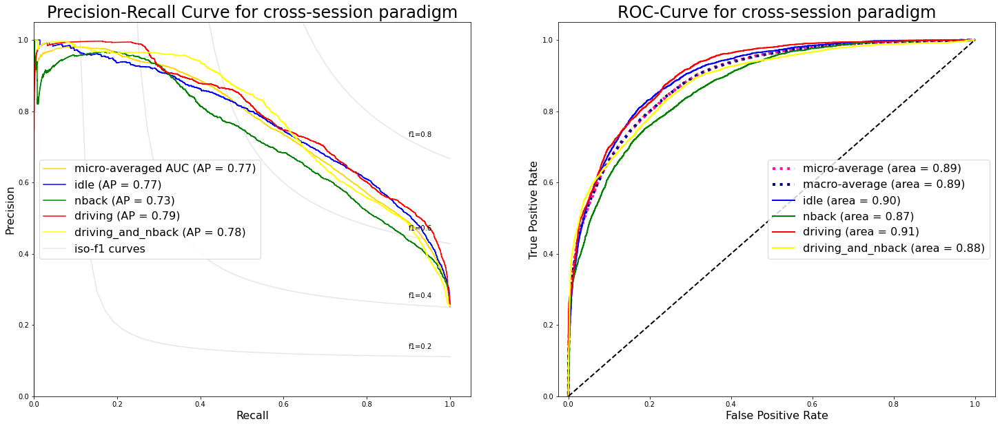

In [ ]:
fig, clf_cross = plot_PR_and_ROC_curves(X_cross_dict_LDA, y_cross_dict, "cross")
fig.show()

In [ ]:
#@title plot projected data and all decision surfaces from the SVC in the lower dimensional subspace found by LDA

def plot_SVC_decision_surfaces(clf, X_dict, y_dict, paradigm):
  
    %matplotlib notebook
    fig = plt.figure(figsize=(20,10))
    ax_lda = fig.add_subplot(111, projection='3d')

    X_total = np.concatenate(list(X_dict.values()), axis=0)
    # removes outliers for proper figure scaling
    p_min, p_max = np.percentile(X_total, [1,99], axis=0)
    x_min, y_min, z_min = p_min
    x_max, y_max, z_max = p_max

    x_lin = np.linspace(x_min, x_max, 30)
    y_lin = np.linspace(y_min, y_max, 30)
    x, y = np.meshgrid(x_lin, y_lin)

    for color, (idx, scenario) in zip(colors, enumerate(scenarios)):
        # compute z values
        f = lambda x, y: (-clf.intercept_[idx]-clf.coef_[idx][0]*x -clf.coef_[idx][1]*y) / clf.coef_[idx][2]
        z = f(x, y)
        # construct mask to hide extreme values outside plot boundaries
        mask = (z>=z_min) & (z<=z_max)
        ax_lda.plot_trisurf(x[mask], y[mask], z[mask], alpha=0, color="white", edgecolors=color, linewidth=1)
        for (jdx, (session, X)), Y in zip(enumerate(X_dict.items()), list(y_dict.values())):
            ax_lda.scatter(X[Y==idx, 0],
                           X[Y==idx, 1],
                           X[Y==idx, 2],
                           color=color,
                           marker=markers[jdx],
                           alpha=0.6,
                           label="s"+str(session)+"_"+scenario if paradigm=="inter" else str(session)+"_"+scenario)

    ax_lda.set_xlabel("First dimensions", fontsize=14)
    ax_lda.set_ylabel("Second dimension", fontsize=14)
    ax_lda.set_zlabel("Third dimension", fontsize=14)

    ax_lda.set_xlim([x_min, x_max])
    ax_lda.set_ylim([y_min, y_max])
    ax_lda.set_zlim([z_min, z_max])

    plt.legend(loc="upper right", shadow=False, scatterpoints=1,prop={'size': 14})

    title_body = paradigm+"-session paradigm ("
    title = title_body+"train size: "+str(round(1/len(list(X_dict.keys())),1))+")" if paradigm=="inter"\
            else title_body+"train size: "+str(round(len(X_dict["train"])/len(X_total), 1))+")"
    plt.title(title, fontsize=24)


    # rotate the axes and update
    def animate(frame):
      ax_lda.view_init(30, frame/4)
      plt.pause(.001)
      return fig

    anim = animation.FuncAnimation(fig, animate, frames=200, interval=50)
    return HTML(anim.to_html5_video())

In [ ]:
plot_SVC_decision_surfaces(clf_inter, X_inter_dict_LDA, y_inter_dict, "inter")

NameError: ignored

In [ ]:
plot_SVC_decision_surfaces(clf_cross, X_cross_dict_LDA, y_cross_dict, "cross")

<IPython.core.display.Javascript object>

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `intercept_` was deprecated in version 0.24 and will be removed in 1.1 (renaming of 0.26). If you observe this warning while using RFE or SelectFromModel, use the importance_getter parameter instead.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `coef_` was deprecated in version 0.24 and will be removed in 1.1 (renaming of 0.26). If you observe this warning while using RFE or SelectFromModel, use the importance_getter parameter instead.
  warnings.warn(msg, category=FutureWarning)


<IPython.core.display.Javascript object>

In [ ]:
results = {}

train_sizes = np.linspace(0.1, 1, 5)
print("length of entire training set:", len(X_multi_train_lda))
for train_size in train_sizes:
    sample_size = round(train_size*len(X_multi_train_lda))
    X_multi_train_lda_sampled = X_multi_train_lda[:sample_size]
    Y_multi_train_sampled = Y_multi_train[:sample_size]
    clf = OneVsRestClassifier(svm.SVC(kernel="linear", C=1, decision_function_shape="ovr", probability=True))
    clf.fit(X_multi_train_lda_sampled, Y_multi_train_sampled)
    y_score = clf.decision_function(X_multi_test_lda)
      
    # micro-average PR-AUC
    micro_pr_auc = average_precision_score(Y_multi_test, y_score, average="micro")
    # micro-average ROC-AUC
    micro_roc_auc = roc_auc_score(Y_multi_test, y_score, average="micro")
    results.update({sample_size:[micro_pr_auc, micro_roc_auc]})
    print("train size in %:", train_size, "#samples:", sample_size, "PR-AUC:", micro_pr_auc, "ROC-AUC:", micro_roc_auc)



In [ ]:
hjcbihwbsdc

In [ ]:
%matplotlib inline
from sklearn.model_selection import learning_curve


clf = OneVsRestClassifier(svm.SVC(kernel="linear", C=1, decision_function_shape="ovr", probability=True))
train_sizes, train_scores, valid_scores = learning_curve(clf,
                                                         X_multi_lda, 
                                                         Y_multi,
                                                         train_sizes=np.linspace(0.1, 1, 5),
                                                         scoring="average_precision",
                                                         cv=5)

train_mean = np.mean(train_scores, axis=1)
train_std = np.std(train_scores, axis=1)

test_mean = np.mean(valid_scores, axis=1)
test_std = np.std(valid_scores, axis=1)

plt.subplots(1, figsize=(10,10))
plt.plot(train_sizes, train_mean, '--', color="#111111",  label="Training score")
plt.plot(train_sizes, test_mean, color="#111111", label="Cross-Validation score")

plt.fill_between(train_sizes, train_mean - train_std, train_mean + train_std, color="#DDDDDD")
plt.fill_between(train_sizes, test_mean - test_std, test_mean + test_std, color="#DDDDDD")

plt.title("Learning Curve")
plt.xlabel("Training Set Size"), plt.ylabel("Accuracy Score"), plt.legend(loc="best")
plt.tight_layout()
plt.show()

In [ ]:
from sklearn.model_selection import GridSearchCV


svm_param_grid={"kernel": ["linear", "poly", "rbf"],
                "C": [1, 2, 4]}  

clf = svm.SVC(kernel="linear", C=1, decision_function_shape="ovr", probability=True)
gscv = GridSearchCV(estimator=clf,
                    param_grid=svm_param_grid,
                    scoring=("roc_auc_ovr", "average_precision"),
                    cv=3,
                    refit="roc_auc_ovr",
                    verbose=4)

gscv.fit(X_multi_lda, y_multi)
results = gscv.cv_results_


In [ ]:
print(results)

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn import preprocessing
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import f1_score, roc_auc_score

rfc_param_grid={"rfc__n_estimators": [100, 300, 900],
                "rfc__max_depth": [1, 2, 4]}

std_scaler = preprocessing.StandardScaler()
rfc = RandomForestClassifier(criterion="gini", random_state=0)
pipeline = Pipeline(steps=[("scaler", std_scaler), ("rfc", rfc)])

gs = GridSearchCV(estimator=pipeline,
                  param_grid=rfc_param_grid,
                  scoring=("roc_auc","f1"),
                  cv=3,
                  refit="roc_auc",
                  verbose=4)

gs.fit(X,y)

results = gs.cv_results_

In [ ]:
from sklearn.ensemble import GradientBoostingClassifier
from sklearn import preprocessing
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import f1_score, roc_auc_score

rfc_param_grid={"gbc__learning_rate": [0.03],
                "gbc__n_estimators": [3000, 9000],
                "gbc__subsample": [0.3],
                "gbc__max_depth": [1]}

std_scaler = preprocessing.StandardScaler()
gbc = GradientBoostingClassifier(loss='exponential', max_features= "sqrt", validation_fraction=0.1, random_state=0)
pipeline = Pipeline(steps=[("scaler", std_scaler), ("gbc", gbc)])

gs = GridSearchCV(estimator=pipeline,
                  param_grid=rfc_param_grid,
                  scoring=("roc_auc","f1"),
                  cv=3,
                  refit="roc_auc",
                  verbose=4)

gs.fit(X,y)

In [ ]:
def plot_grid_search(cv_results, grid_param_1, grid_param_2, name_param_1, name_param_2):
    # Get Test Scores Mean and std for each grid search
    scores_mean = cv_results['mean_test_score']
    scores_mean = np.array(scores_mean).reshape(len(grid_param_2),len(grid_param_1))

    scores_sd = cv_results['std_test_score']
    scores_sd = np.array(scores_sd).reshape(len(grid_param_2),len(grid_param_1))

    # Plot Grid search scores
    _, ax = plt.subplots(1,1)

    # Param1 is the X-axis, Param 2 is represented as a different curve (color line)
    for idx, val in enumerate(grid_param_2):
        ax.plot(grid_param_1, scores_mean[idx,:], '-o', label= name_param_2 + ': ' + str(val))

    ax.set_title("Grid Search Scores", fontsize=20, fontweight='bold')
    ax.set_xlabel(name_param_1, fontsize=16)
    ax.set_ylabel('CV Average Score', fontsize=16)
    ax.legend(loc="best", fontsize=15)
    ax.grid('on')

# Calling Method 
plot_grid_search(gs.cv_results_, n_estimators, max_features, 'N Estimators', 'Max Features')